## Import required Libraries

In [3]:
import pickle
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import random

from moviepy.editor import VideoFileClip
from IPython.display import HTML
from Model_final import *

## Goal of this Project
The goal of this project to write a software pipeline to identify the lane boundaries in a video from a front-facing camera on a car. Use various techniques (described in detail below) to identify and draw the inside of a lane, compute lane curvature, and even estimate the vehicle's position relative to the center of the lane

## Image Distortion
Images taken using lens camera often suffer from image distortion. Image distortion occurs when a camera looks at 3D objects in the real world and transforms them into a 2D image; this transformation is not perfect. Distortion actually changes what the shape and size of these 3D objects appear to be. So, the first step in analyzing camera images, is to undo this distortion so that you can get correct and useful information out of them

*Following text is from lecture Notes*  


**Types of Distortion**  
Real cameras use curved lenses to form an image, and light rays often bend a little too much or too little at the edges of these lenses. This creates an effect that distorts the edges of images, so that lines or objects appear more or less curved than they actually are. This is called **radial distortion**, and it’s the most common type of distortion.

Another type of distortion, is **tangential distortion**. This occurs when a camera’s lens is not aligned perfectly parallel to the imaging plane, where the camera film or sensor is. This makes an image look tilted so that some objects appear farther away or closer than they actually are.


## Step1 : Find Chess Board Corners

We have learned that distortion changes the size and shapes of the object in an image. We will have to correct or calibrate this before performing any analysis.  
We can take pictures of any known shapes and detect the distortion errors. Ideal picture would be a chess board. A chess board is great for distortion correction because of its regular and high contrast pattern makes it easy to detect the distortion automatically.

**How do we use chess board to do distortion correction?**  
Take multiple images of chess board places against a flat surface from different angles and detect the distortion by looking at the difference between the size/shape of the squares in the images vs size/shape of the squares in the actual undistorted image.  Use this difference information to calibrate the images taken from the camera.  
In Short, map distorted points in a distorted chess image to undistorted points to un-distort any images.



#### **Code Comments**
We'll use OpenCV functions findChessboardCorners() and drawChessboardCorners() to automatically find and draw corners in an image of a chessboard pattern.

Our task is to map the co-ordinates of the corners in 2D image (imgpoints) to the 3D co-ordinates of real undistorted chessboard corners (objpoints).  So let's first initiate two empty lists called imgpoints and objpoints.


    1. Prepare the object points by initiating an array objp with 6x9 points in an array each with 3 columns x,y,z. This grid contains all zeros.
    2. Z co-ordinate is always 0. Hence leave that as it is and generate x,y co-ordinates using numpy's mgrid function. These object points are corner co-ordinates of known 3D chess board(x,y,z). Since we have 9 x 6 corners, our objp starts from (0,0,0) and end at (7,5,0).
    3. Read images of chess board taken from different angles.
    4. Use OpenCV function cv2.findChessboardCorners() to detect the number of corners. Corners are the points where Black and White squares intersect. The chess board images we read have 9 corners on horizontal axis and 6 corners on vertical axis.
    5. cv2.findChessboardCorners() returns the corner points.
    6. For every image, if corners are detected, append those corners to imgpoints array and append objp co-ordinates to objpoints array
    7. use OpenCV function cv2.drawChessboardCorners() to draw the detected corner points on the Chess board image.
    
Now we have a bunch of image points of corners detected on source distorted image and a bunch of object points (targets) of the Undistorted image. Now to Undistort any image, we have to simply map these image points to destination's object points. We'll see how to do that in the next section.  

Calculating image points and object points is a time consuming expensive action. It's a good practice to store them in a pickle object for later use.

In [4]:
def camera_calbiration(images_path, nx, ny):
    
    
    objp = np.zeros((ny*nx,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Step through the list and search for chessboard corners
    calibrated_images = []
    for idx, fname in enumerate(images_path):
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
            calibrated_images.append(img)
            
    #Save Image and object points to pickle disk
    dist_pickle = {}
    dist_pickle["objpoints"] = objpoints
    dist_pickle["imgpoints"] = imgpoints
    pickle.dump( dist_pickle, open( "wide_dist_pickle.p", "wb" ) ) 
    return calibrated_images
    
 # Make a list of calibration images
images_path = glob.glob('camera_cal/calibration*.jpg')
num_corners_x = 9
num_corners_y = 6
calibrated_images = camera_calbiration(images_path, num_corners_x, num_corners_y)   

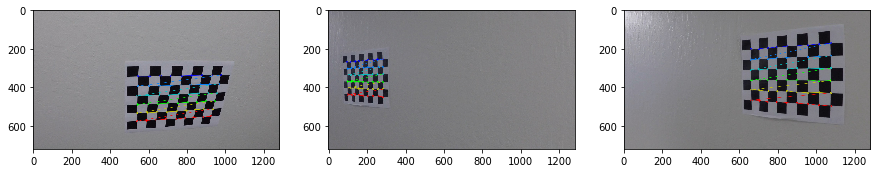

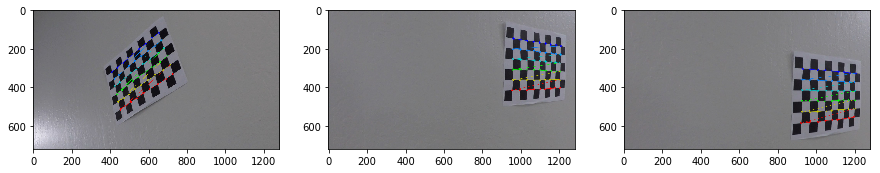

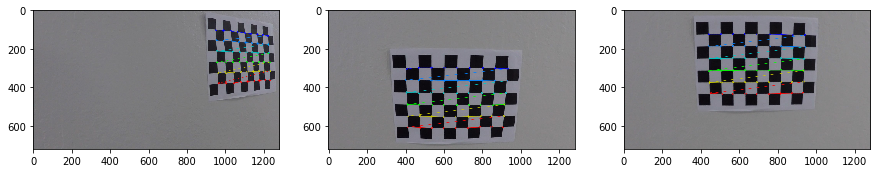

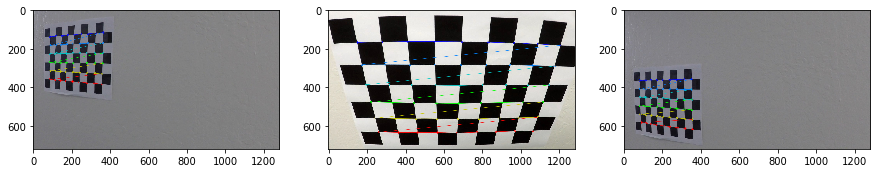

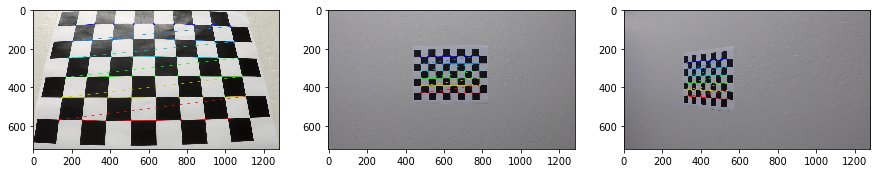

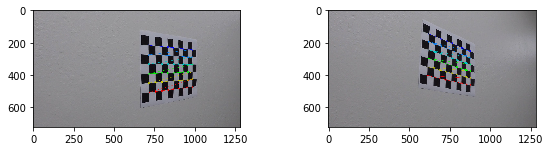

In [5]:
n_images = len(calibrated_images)
images_per_row = 3
num_rows = np.int(np.ceil(n_images/images_per_row))
i = 1
j = 1
plt.figure(figsize=(15,15))
for row in range(n_images):    
    plt.subplot(i,3,j)     
    plt.imshow(calibrated_images[row])
    j += 1
    if j == 4:
        plt.figure(figsize=(15,15))
        j = 1
        i += 1


## Step 2: Calibrate Camera and Distortion Correction
  

OpenCV function cv2.calibrateCamera() takes in image points,object points and shape of the input image. It calculates and returns the distortion coeffecients and the camera matrix that we need to transform 3D object points to 2D image points. It also returns the position of the camera in the world with values for rotation and translation vectors.  
Next step we need is to undistort an image. We can do this using OpenCV's cv2.undistort() function which takes in the image, camera matrix and distortion coeffecients and returns undistorted/ destination image.


#### Code comments #### 
    1. Read image points and object points from pickle. We'll use these points to calibrate the camera and undistort the        images.
    2. Define a function cal_distort() which takes in an image, camera matrix and distortion coeffecients and pass these on     to OpenCV's cv2.undistort() function.
    3. Return undistorted/destination image.
    4. Invoke cv2.calibrateCamera() which takes in image points,object points and shape of the input image. It calculates and   returns the distortion coeffecients and the camera matrix that we need to transform 3D object points to 2D image         points.  It also   returns the position of the camera in the world with values for rotation and translation vectors.  
    5. Call cal_distort() with image, camera matrix and distortion coeffecients as parameters and obtain the undistorted image.

In [6]:
# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "wide_dist_pickle.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

# Performs the camera calibration, image distortion correction and 
# Return the undistorted image
def cal_undistort(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist


img = mpimg.imread('camera_cal/calibration1.jpg')
gray = cv2.cvtColor(img , cv2.COLOR_BGR2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "wide_dist_pickle.p", "wb" ) )

images_path = glob.glob('camera_cal/calibration*.jpg')
random_5 = [random.randint(0, 19) for i in range(5)]
undistorted_images = []
original_images = []
for idx, fname in enumerate(images_path):
    img = mpimg.imread(fname)    
    original_images.append(img)
    undistorted_images.append(cal_undistort(img, mtx, dist))

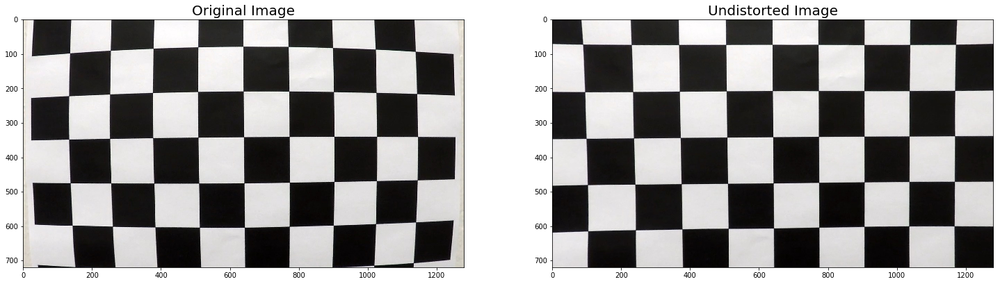

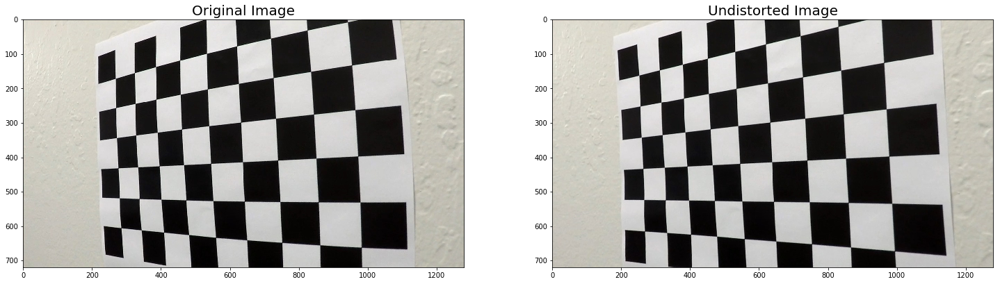

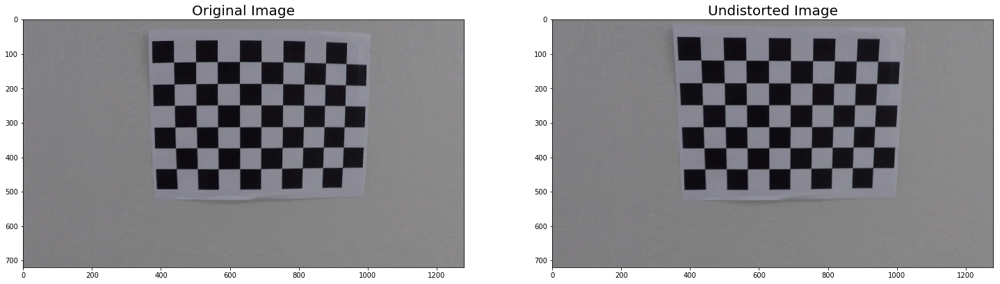

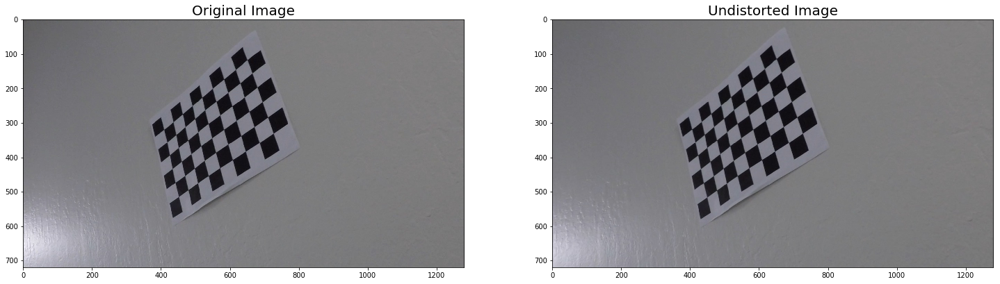

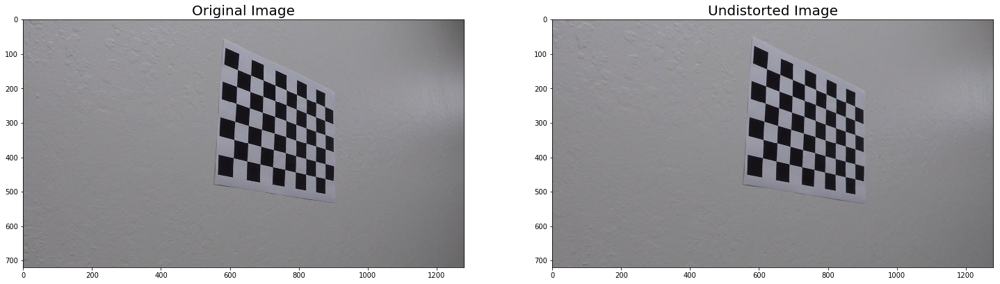

In [7]:
for idx in random_5:    
    fig = plt.figure(figsize=(25, 25))  
    ax1 = fig.add_subplot(1,2,1)
    ax1.set_title('Original Image', fontsize=20)  
    ax1.imshow(original_images[idx])
    
    ax2 = fig.add_subplot(1,2,2)
    ax2.set_title('Undistorted Image', fontsize=20) 
    ax2.imshow(undistorted_images[idx])

### Test Undistortion on Car-Road Images

#### Code comments #### 
Use cal_distort() created above to test the undistortion on actual Car-Road Images.

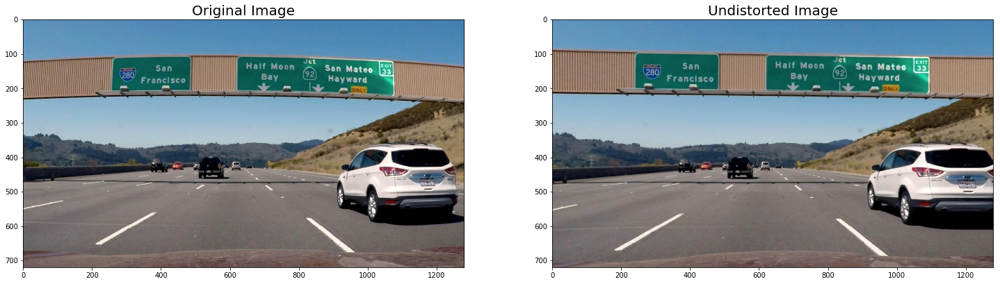

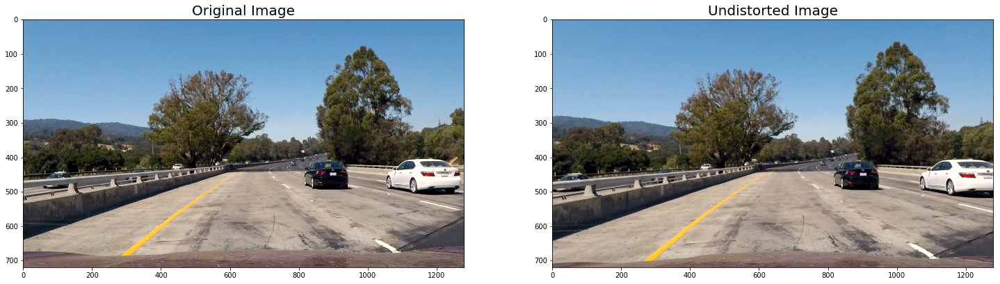

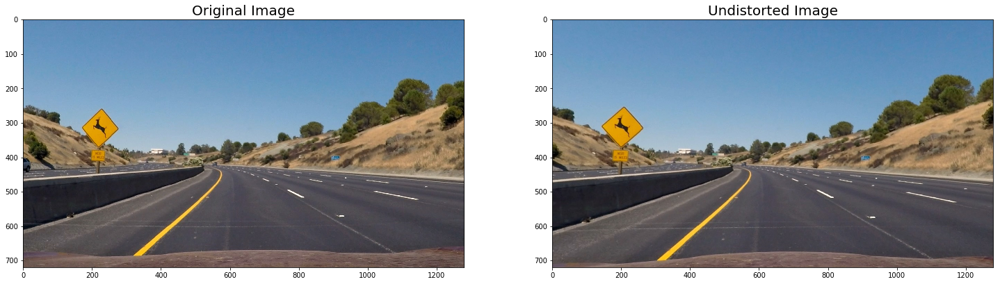

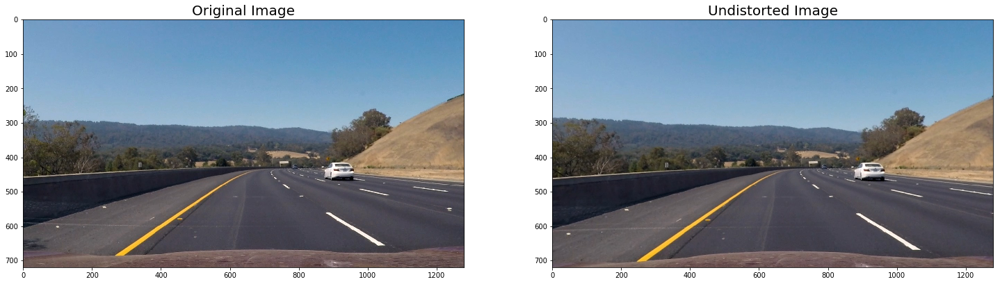

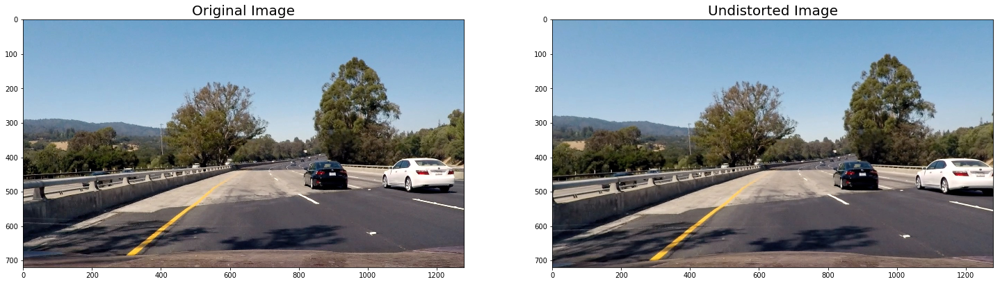

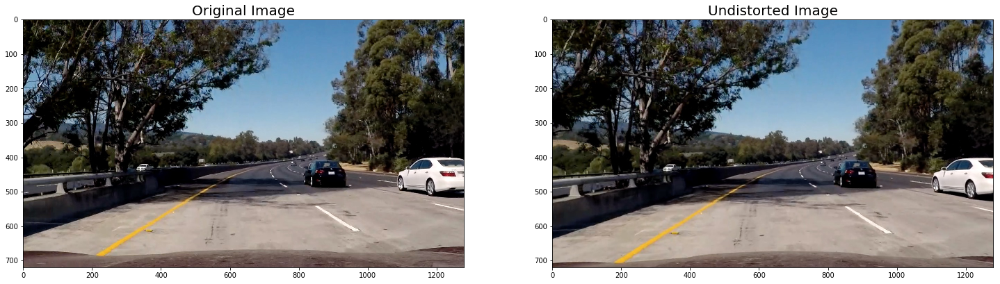

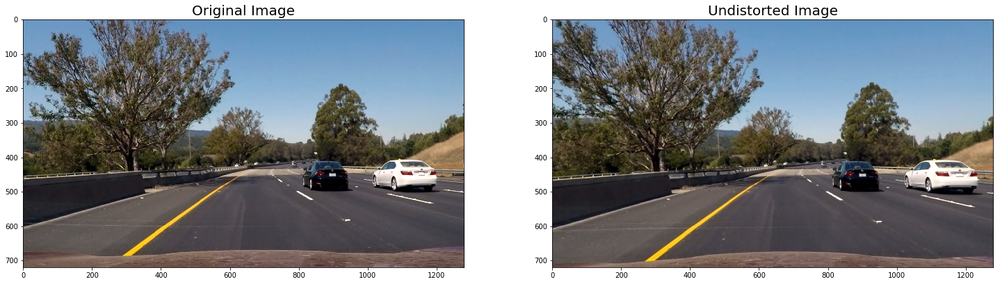

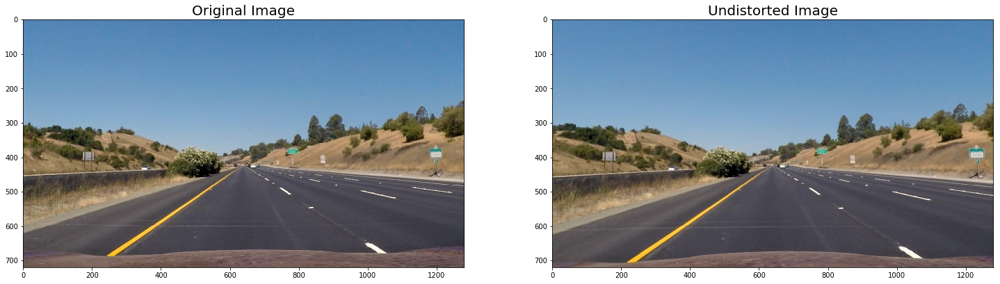

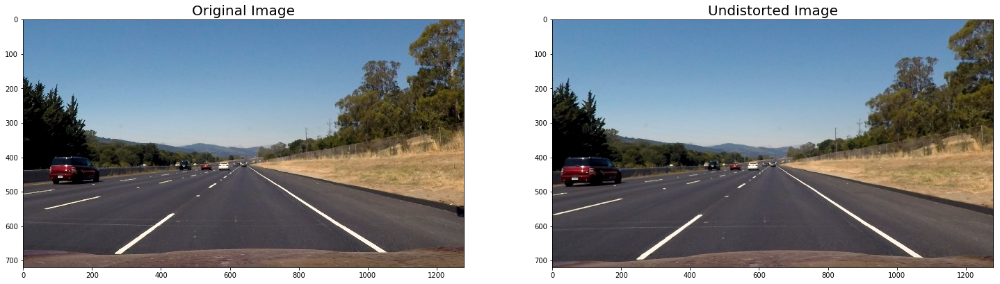

In [8]:
# Test undistortion on an image
img = mpimg.imread('test_images/test1.jpg')
gray = cv2.cvtColor(img , cv2.COLOR_BGR2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)

all_test_images = glob.glob('test_images/*.jpg')

undistorted_images = []
original_images = []
for idx, fname in enumerate(all_test_images):
    img = mpimg.imread(fname)    
    original_images.append(img)
    undistort_image = cal_undistort(img, mtx, dist)
    undistort_image_name = 'undistort_' + fname
    undistorted_images.append(undistort_image)
    
for idx in range(len(all_test_images)):    
    plt.figure(figsize=(25, 25))  
    plt.subplot(1,2,1)
    plt.title('Original Image', fontsize=20) 
    plt.imshow(original_images[idx])
    
    plt.subplot(1,2,2)
    plt.title('Undistorted Image', fontsize=20) 
    plt.imshow(undistorted_images[idx])    

## Step 3: Explore Color Spaces
Explore different color spaces to see which color space and channels are most effective to separate lane lines.

We'll see how to do that in the following sections.

*Following text take from lecture notes*  
A color space is a specific organization of colors; color spaces provide a way to categorize colors and represent them in digital images.  

**RGB** is red-green-blue color space. You can think of this as a 3D space, in this case a cube, where any color can be represented by a 3D coordinate of R, G, and B values. For example, white has the coordinate (255, 255, 255), which has the maximum value for red, green, and blue.  

There are many other ways to represent the colors in an image besides just composed of red, green, and blue values.  

There is also **HSV** color space (hue, saturation, and value), and **HLS** space (hue, lightness, and saturation). These are some of the most commonly used color spaces in image analysis.  

To get some intuition about these color spaces, you can generally think of **Hue** as the value that represents color independent of any change in brightness. So if you imagine a basic red paint color, then add some white to it or some black to make that color lighter or darker -- the underlying color remains the same and the hue for all of these colors will be the same.  

On the other hand, **Lightness and Value** represent different ways to measure the relative lightness or darkness of a color. For example, a dark red will have a similar hue but much lower value for lightness than a light red. Saturation also plays a part in this; saturation is a measurement of colorfulness. So, as colors get lighter and closer to white, they have a lower saturation value, whereas colors that are the most intense, like a bright primary color (imagine a bright red, blue, or yellow), have a high saturation value. You can get a better idea of these values by looking at the 3D color spaces pictured below.  

Most of these different color spaces were either inspired by the human vision system, and/or developed for efficient use in television screen displays and computer graphics. You can read more about the history and the derivation of HLS and HSV color spaces [here](https://en.wikipedia.org/wiki/HSL_and_HSV).

In [9]:
def convert_color(img, cspace = 'RGB'):
    if cspace != 'RGB':
        if cspace == 'HSV':
            new_color_space = cv2.COLOR_RGB2HSV
        elif cspace == 'HLS':
            new_color_space = cv2.COLOR_RGB2HLS
        elif cspace == 'LUV':
            new_color_space = cv2.COLOR_RGB2LUV
        elif cspace == 'YUV':
            new_color_space = cv2.COLOR_RGB2YUV
        elif cspace == 'LAB':
            new_color_space = cv2.COLOR_RGB2Lab
        elif cspace == 'HLS':
            new_color_space = cv2.COLOR_RGB2HLS   
        elif cspace == 'RGB2YCrCb':
            new_color_space = cv2.COLOR_RGB2YCrCb
        elif cspace == 'BGR2YCrCb':
            new_color_space = cv2.COLOR_BGR2YCrCb
        elif cspace == 'BGR2LUV':
            new_color_space = cv2.COLOR_BGR2LUV
        img_converted = cv2.cvtColor(img, new_color_space)
    else:
        img_converted = np.copy(img)   
    return img_converted

def explore_color_space(img, color_space, thresh_ch1, thresh_ch2, thresh_ch3):
        
    img = convert_color(img, color_space)
    plt.figure(figsize=(15, 15))  
    plt.title(color_space + ' Image', fontsize=20) 
    plt.imshow(img)
    
    row = 1
    for i in range(3):
        plt.figure(figsize=(10, 10))  
        if i == 0:
            thresh = thresh_ch1
        elif i == 1:
            thresh = thresh_ch2
        else:           
            thresh = thresh_ch3
        
        channel_img = img[:,:,i] 
        plt.subplot(row,2,1)
        plt.title(color_space[i] + ' Channel', fontsize=20) 
        plt.imshow(channel_img, cmap ='gray')    
        
        binary = np.zeros_like(channel_img)
        binary[(channel_img > thresh[0]) & (channel_img <= thresh[1])] = 1
        
        plt.subplot(row,2,2)
        plt.title(color_space[i] + ' Binary', fontsize=20) 
        plt.imshow(binary, cmap ='gray')    
        
        row += 1
         

#### Plot Images of each individual channel of RGB image ####
Explore thresholding individual RGB color channels. Take a look at them side by side to see which ones do a better job of picking up the lane lines.  
Observe that the Blue channel completely obscures the Yellow line on the left. Any thresholding you apply does a poor job on picking up the lanes.  
Red Channel does do a reasonable good job.

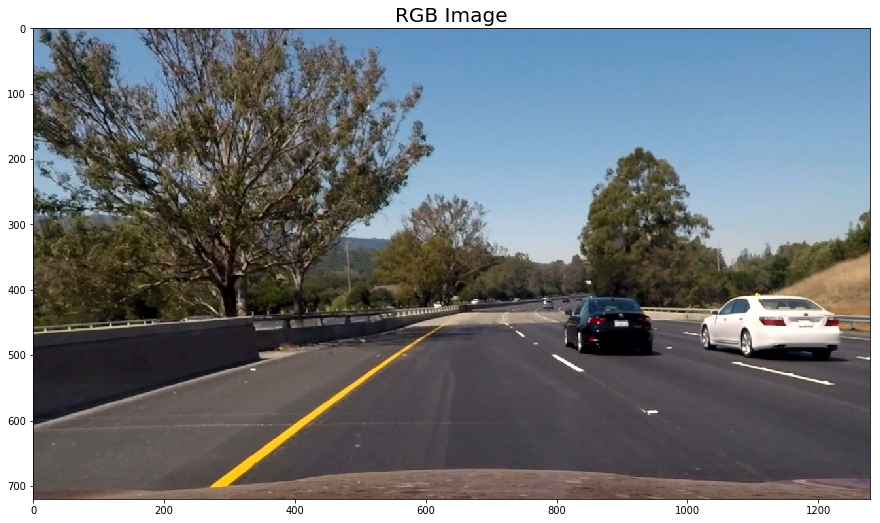

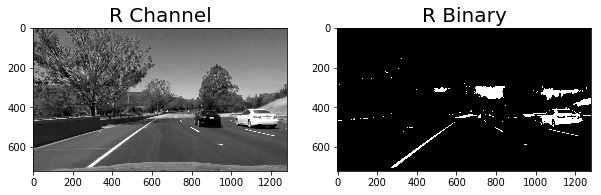

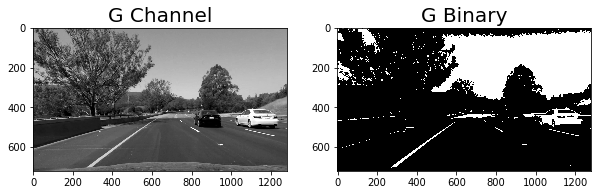

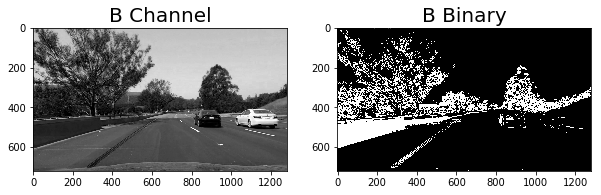

In [10]:
image = mpimg.imread('test_images/test6.jpg')
undistort_image = cal_undistort(image, mtx, dist)
color_space = 'RGB'
thresh_ch1 = (180, 255)
thresh_ch2 = (150, 255)
thresh_ch3 = (20, 50)
explore_color_space(undistort_image, color_space, thresh_ch1, thresh_ch2, thresh_ch3)

#### Let's examine Images of each individual channel of HLS image ####
At first look, S channel does an excellent job in picking up the lane lines. Experimenting with threshold values on this channel may yield interesting results.  
S channel does a fairly good job of picking up the lines under very different color and contrast conditions, while the other selections look messy. After experimenting with several thresholds, the range (180,255) gave us a good result.


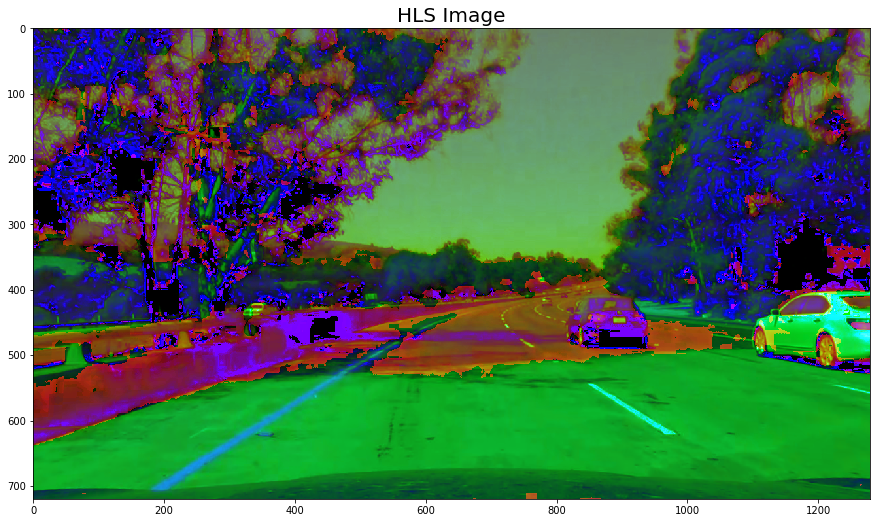

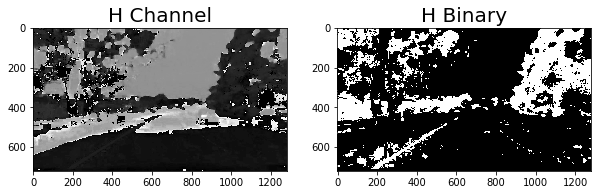

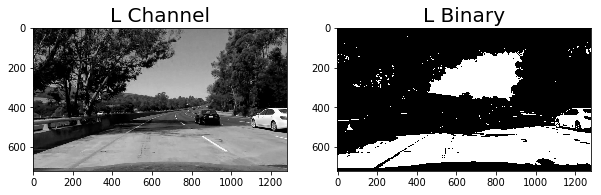

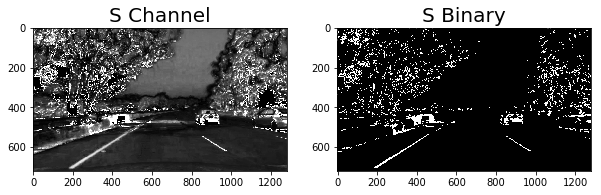

In [11]:
image = mpimg.imread('test_images/test5.jpg')
undistort_image = cal_undistort(image, mtx, dist)
color_space = 'HLS'
thresh_ch1 = (15, 80)
thresh_ch2 = (150, 255)
thresh_ch3 = (180, 255)
explore_color_space(undistort_image, color_space, thresh_ch1, thresh_ch2, thresh_ch3)

In [12]:
def plot(n_images, image1, image2, image3, title1, title2, title3, xy_coords = None, plot_coords = False):
    
    if n_images == 2:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 15))
    elif  n_images == 3:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
        
    f.tight_layout()

    ax1.imshow(image1)
    if plot_coords:
        ax1.plot(xy_coords[0], xy_coords[1], color='red', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)        
    ax1.set_title(title1, fontsize=10)
    
    ax2.imshow(image2, cmap='gray')
    ax2.set_title(title2, fontsize=10)

    if n_images == 3:
        ax3.imshow(image3, cmap='gray')
        ax3.set_title(title3, fontsize=10)

    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Step 4: Apply Color and Gradient Thresholds

### Sobel Threshold
Applying the Sobel operator to an image is a way of taking the derivative of the image in the x or y direction. You can read more about the Sobel operator [here](https://en.wikipedia.org/wiki/Sobel_operator).

Let's read an image and observe how sobel threshold applied in x and y orientations gives us different results. 
Our observations earlier helped us understand the individual channels in HLS image pick up lanes well and L&S channel do a good job of all. In this experiment, we'll use HLS's L&S channels to apply sobel operator.  



**Code Comments**:
Set min_thresh, and max_thresh to specify the range to select for **binary output**. You can use exclusive (<, >) or inclusive (<=, >=) thresholding.

In [13]:
def abs_sobel_threshold(img, gradient_thresh = (0, 255), orient='x', sobel_kernel = 3):
       
    # Apply the following steps to img
    # Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        sobelxy = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)        
    else:
        sobelxy = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the derivative or gradient
    abs_sobelxy = np.absolute(sobelxy)
    # Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255 * abs_sobelxy / np.max(abs_sobelxy))
    # Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= gradient_thresh[0]) & (scaled_sobel <= gradient_thresh[1])] = 1
    # Return this mask as your binary_output image    
    return grad_binary

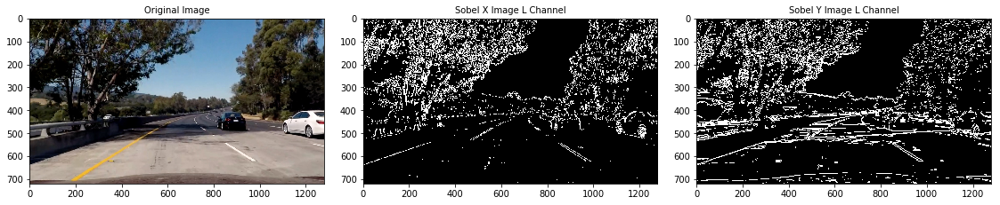

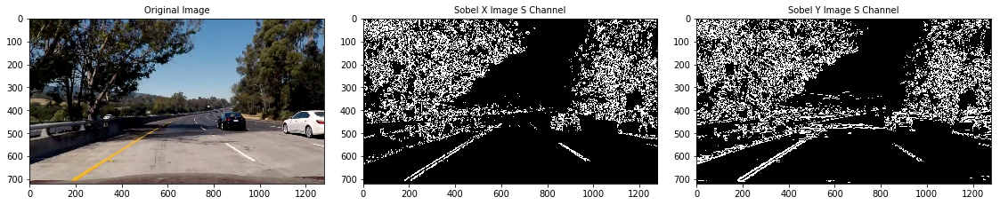

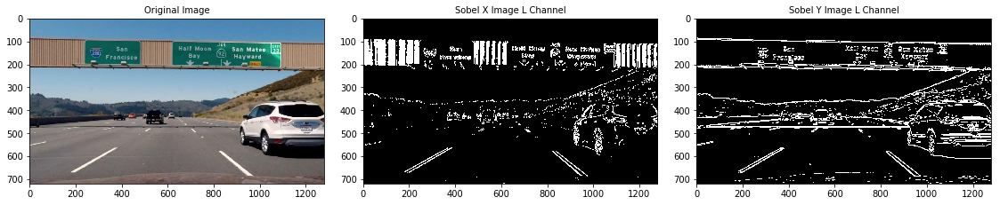

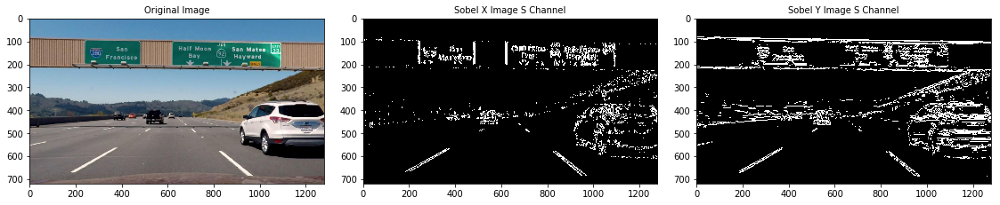

In [14]:
images = [mpimg.imread('test_images/test5.jpg'), mpimg.imread('test_images/signs_vehicles_xygrad.jpg')]
undistort_images = []
L_Channel_images = []
S_Channel_images = []
for image in images:
    undistort_image = cal_undistort(image, mtx, dist)
    undistort_images.append(undistort_image)
    HLS_image = cv2.cvtColor(undistort_image, cv2.COLOR_RGB2HLS)
    L_Channel = HLS_image[:,:,1]
    L_Channel_images.append(L_Channel)
    S_Channel = HLS_image[:,:,2]
    S_Channel_images.append(S_Channel)
    sobel_x_image = abs_sobel_threshold(L_Channel, gradient_thresh = (20, 120), orient='x', sobel_kernel = 5)
    sobel_y_image = abs_sobel_threshold(L_Channel, gradient_thresh = (20, 120), orient='y', sobel_kernel = 5)
    plot(3, undistort_image, sobel_x_image, sobel_y_image, 'Original Image', 'Sobel X Image L Channel', 'Sobel Y Image L Channel')

    sobel_x_image = abs_sobel_threshold(S_Channel, gradient_thresh = (20, 120), orient='x', sobel_kernel = 5)
    sobel_y_image = abs_sobel_threshold(S_Channel, gradient_thresh = (20, 120), orient='y', sobel_kernel = 5)
    plot(3, undistort_image, sobel_x_image, sobel_y_image, 'Original Image', 'Sobel X Image S Channel', 'Sobel Y Image S Channel')

Taking the gradient in the x direction emphasizes edges closer to vertical. Alternatively, taking the gradient in the y direction emphasizes edges closer to horizontal.  

Threshold range 20 to 120 and kernel size of 5 seems to work well and L channel detects the lanes very well.  

1. In the first image, L channel was able to detect the lane curve which is far ahead.
2. Observe that in the second image, the shadows of the foot over bridge on the road are picked up in L channel's Y direction gradients. But S Channel combined with set thresholds was able to remove the shadow and detect only the lanes. 

L channel was able to pick up lane markings well (though with added noise like foot over bridge shadows). In the following sections, we learn how to combine these multiple characteristics and form a desired binary image with reduced noise and reasonable lane detections.
Moving forward, we'll use L channel to apply Magnitude and Direction gradients. 

### Magnitude of the Gradient
In the above images, you can see that the gradients taken in x direction was able to isolate lane lines very well.  
y-direction also picks up lanes well but adds some noise. Observe that the shadows of the foot over bridge on the road are picked up as well.  
To be able to use information in both the directions, You can now take the gradient in x or y directions and set thresholds to identify pixels within a certain gradient range.  The magnitude, or absolute value, of the gradient is just the square root of the squares of the individual x and y gradients.  

For a gradient in both the x and y directions, the magnitude is the square root of the sum of the squares.

Let's read an image and see how Gradient thresholds work. Threshold range 30 to 190, increased kernel size to 7 seems to work well and picks up all the lanes the vehicle is in.

In [15]:
def mag_threshold(img, mag_thresh = (0, 255), sobel_kernel = 3):
       
    abs_sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    abs_sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    sobel_magnitude = np.sqrt(abs_sobelx**2 + abs_sobely**2)
    sobel_magnitude = np.absolute(sobel_magnitude)
    # Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = np.uint8(255 * sobel_magnitude / np.max(sobel_magnitude))
    
    mag_binary = np.zeros_like(scaled_sobel)
    mag_binary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    
    return mag_binary

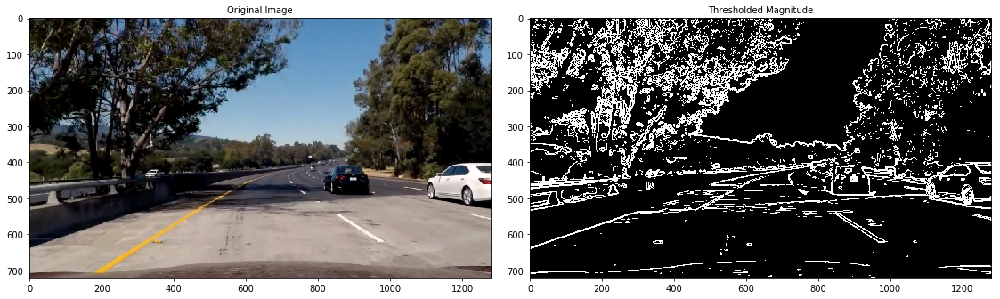

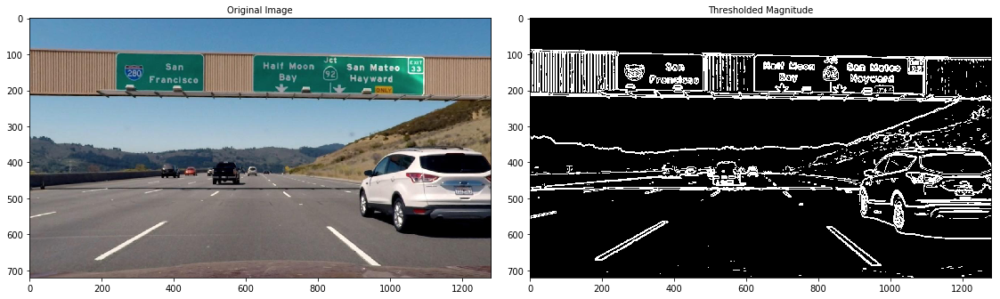

In [16]:
for idx, image in enumerate(undistort_images):
    gradient_image = mag_threshold(L_Channel_images[idx], mag_thresh = (30, 190), sobel_kernel = 7)
    plot(2, image, gradient_image, None, 'Original Image', 'Thresholded Magnitude', None)

###  Direction of the Gradient
*Text taken from Lecture notes*  
When you play around with the thresholding for the gradient magnitude in the previous exercise, you find what you might expect, namely, that it picks up the lane lines well, but with a lot of other stuff detected too. Gradient magnitude is at the heart of Canny edge detection, and is why Canny works well for picking up all edges.

In the case of lane lines, we're interested only in edges of a particular orientation. So now we will explore the direction, or orientation, of the gradient.  
The direction of the gradient is simply the inverse tangent (arctangent) of the y gradient divided by the x gradient. Each pixel of the resulting image contains a value for the angle of the gradient away from horizontal in units of radians, covering a range of -pi/2 to pi/2.  

An orientation of 0 implies a vertical line and orientations of +/- pi/2 imply horizontal lines. We'll take the absolute value of Sobel X, this restricts the values to +/- pi/2.

Let's read an image and see how Direction thresholds work. Threshold range 0.6 to 1.4 seems to work well combined with the kernel size  of 15.

In [17]:
def dir_threshold(img, dir_thresh=(0.7, 1.3), sobel_kernel = 3):
    
    # Apply the following steps to img
    # Take the gradient in x and y separately
    # Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    abs_sobely = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel))    
    
    # Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    gradient_direction = np.arctan2(abs_sobely, abs_sobelx)
    # Create a binary mask where direction thresholds are met
    dir_binary = np.zeros_like(gradient_direction)
    dir_binary[(gradient_direction >= dir_thresh[0]) & (gradient_direction <= dir_thresh[1])] = 1
    # Return this mask as your binary_output image    
    return dir_binary

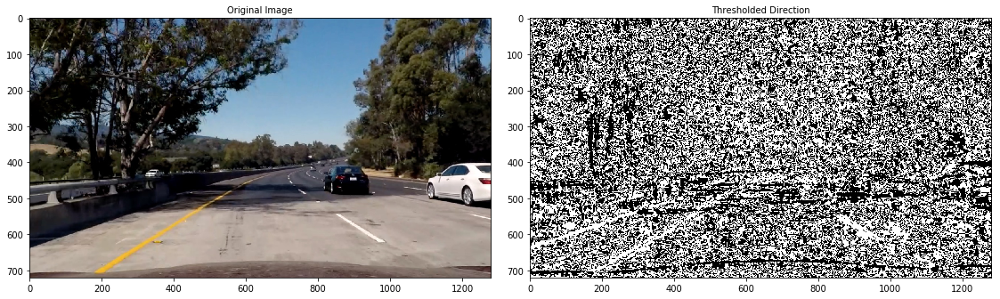

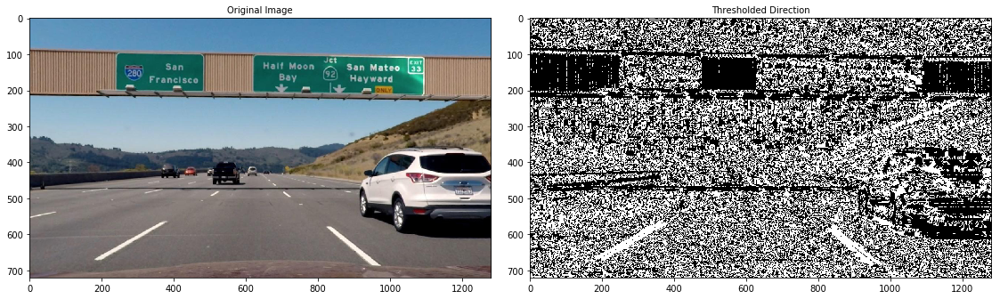

In [18]:
for idx, image in enumerate(undistort_images):
    direction_image = dir_threshold(L_Channel_images[idx], dir_thresh = (0.6, 1.4), sobel_kernel = 15)
    plot(2, image, direction_image, None, 'Original Image', 'Thresholded Direction', None)

###  Combining Thresholds
We can  now use various aspects of the gradient measurements (x, y, magnitude and direction) to isolate lane pixels. The idea is to combine the binary images generated using different thresholds using different gradient measurements.
After several experiments, following thresholds gave us good results:
1. Color threshold range between 180 and 255 applied on S channel of HLS image. 
2. Gradient threshold between the range 20 and 120 applied on L channel of HLS image. (on image with gradients taken in X direction). Kernel size used is 5.
3. Magnitude threshold between the range 30 and 190 applied on L channel of HLS image. Kernel size used is 7.
4. Direction threshold between the range 0.6 and 1.4 applied on L channel of HLS image.

**Combined Thresholds**
Gradients detected in X direction within the specified range OR Combined detections of gradients when Magnitude and Direction threshold applied OR Image after color thresholds applied.  

**Region of Interest**  
Before generating the final image, apply the region of interest to mask unnecessary details in the image. We are interested only in the portion of an image where lanes where the car is being driven are detected. Black our rest of the portion of the image.


**Final Images on the right side isolate lane lines**

In [19]:
def color_gradient_threshold(img, kernel_sizes,
                             color_thresh=(0, 255), 
                             gradient_thresh=(0, 255),
                             magnitude_thresh = (0, 255),
                             direction_thresh = (0.0, 0.9)):
    
    
       
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    L_channel = hls[:,:,1]
    S_channel = hls[:,:,2]
    sx_binary = abs_sobel_threshold(L_channel, gradient_thresh, orient='x', sobel_kernel = kernel_sizes[0])
    sy_binary = abs_sobel_threshold(L_channel, gradient_thresh, orient='y', sobel_kernel = kernel_sizes[0])
    mag_binary = mag_threshold(L_channel, magnitude_thresh, sobel_kernel = kernel_sizes[1])
    dir_binary = dir_threshold(L_channel, direction_thresh, sobel_kernel = kernel_sizes[2])   
    
       
    # Apply Color Thresholds
    s_binary = np.zeros_like(S_channel)
    s_binary[(S_channel >= color_thresh[0]) & (S_channel <= color_thresh[1])] = 1
    
    combined_binary = np.zeros_like(sx_binary)
    combined_binary[(sx_binary == 1) | ((mag_binary == 1) & (dir_binary == 1)) | ((s_binary == 1))] = 1     
    
    return combined_binary

In [20]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

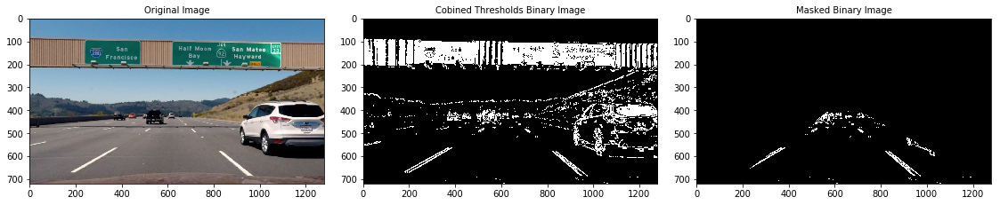

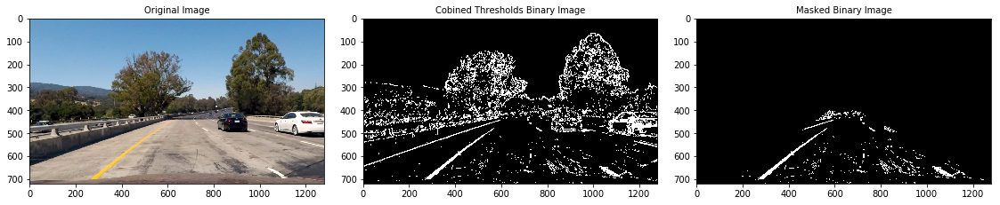

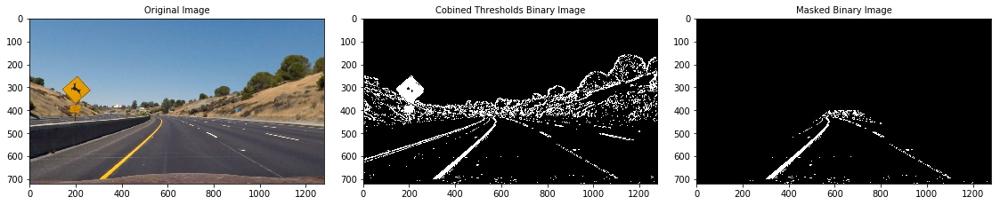

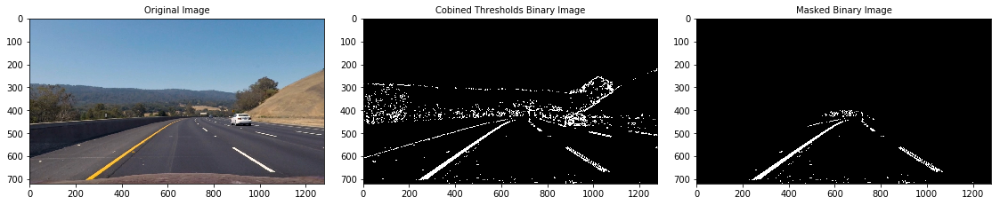

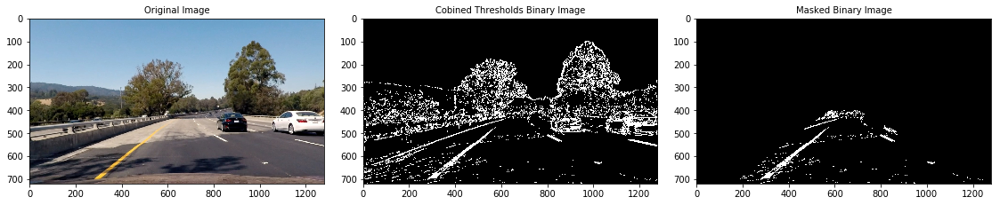

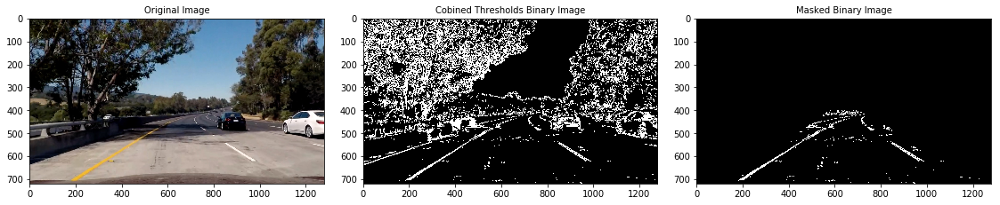

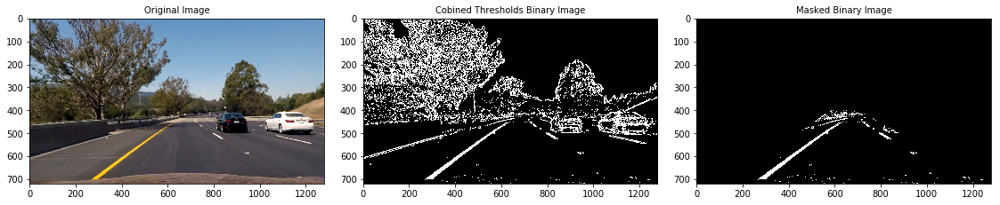

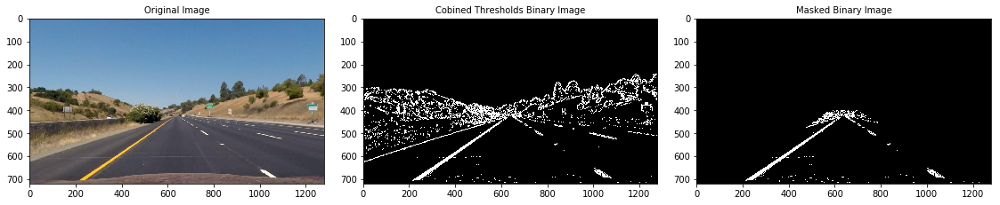

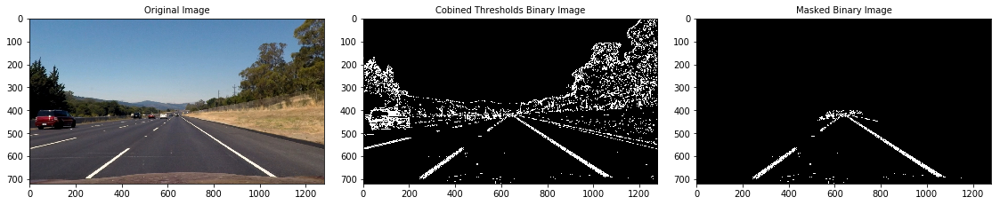

In [21]:
all_test_images = glob.glob('test_images/*.jpg')

for idx, fname in enumerate(all_test_images):
    image = mpimg.imread(fname)
    undistort_image = cal_undistort(image, mtx, dist)
    combined_binary = color_gradient_threshold(undistort_image, 
                                               kernel_sizes = [5,7,15],
                                               color_thresh=(180, 255), 
                                               gradient_thresh=(20, 120),
                                               magnitude_thresh = (30, 190),
                                               direction_thresh = (0.6, 1.4)
                                              )
    
    img_height = image.shape[0]
    img_width = image.shape[1]
    vertices = np.array([[(140, img_height), (580, 400), (700, 400),(img_width, img_height)]], np.int32)
    masked_image = region_of_interest(combined_binary, vertices) 
    plot(3, undistort_image, combined_binary, masked_image, 'Original Image', 'Cobined Thresholds Binary Image', 'Masked Binary Image')
        
    
   

## Step 4: Perspective Transform
In an image, perspective is the phenomenon that the object appears smaller the farther they are  from a viewpoint of a camera. And parallel lines appear to converge to point.

In this context, the lanes look smaller and smaller the farther away they get from the camera.
Perspective transform converts the 3D world's perspective of an image into 2D image representation.This process warps the image by dragging points towards or away from the camera.   
In this task, we transform the lane images into a bird's eye view representation. This is useful in making it easy to assess the curvature of the lane when looked from a bird's eye/ top down view of an image.

![](Document_images/perspective_transform.jpg)

**Code Comments**
        1. Select 4 points representing a plane on 3D perspective image. (src). We select these 4 points to identify a lane curvature when look from top view. (As shown above).
        2. Select 4 points where we want them to appear on the transformed/warped image (dst).
        3. Use Open CV's cv2.getPerspectiveTransform() function to apply perspective transform. This functions maps the points in the original image to the points in the transformed image with a different perspective. Returns a mapping M as perspective matrix.
        4. You can also use the same function to change the perspective from warped image to the original image. (by passing dst and src)
        5. Then use cv2.warpPerspective() function, pass the Mappng M obtained in step 3 to get the warped image.
        6. Stack up all these points in sequence to create the function perspective_transform()
        

In [22]:
def perspective_transform(undistorted_image, img_size, src, dst):
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(undistorted_image, M, img_size, flags = cv2.INTER_LINEAR) 
    return warped, M, Minv

## Step 5: Build the pipeline
Build the pipeline to construct all the above steps in sequence to get the final warped image. Create the  
1. Undistort the image
2. Apply Color threshold range between 180 and 255 applied on S channel of HLS image.
3. Apply Gradient threshold between the range 20 and 120 applied on L channel of HLS image. (on image with gradients taken in X direction). Kernel size used is 5.
4. Apply Magnitude threshold between the range 30 and 190 applied on L channel of HLS image. Kernel size used is 7.
5. Apply Direction threshold between the range 0.6 and 1.4 applied on L channel of HLS image.
6. Combine Thresholds applied in steps 2 to 5 to get the final binary image
7. Apply perspective transform on the Binary image.
8. Final warped image along with the Mapping matrix to unwarp the image later


In [23]:
def pipeline(image, plot_images = False):
    image_size = (image.shape[1],image.shape[0])
    img_height = image.shape[0]
    img_width = image.shape[1]
    offset = 450
    
     
    src = np.float32([(572,465),
                  (730,465), 
                  (290,680), 
                  (1090,680)])
    dst = np.float32([(offset , 0),
                  (img_width - offset , 0),
                  (offset , img_height),
                  (img_width - offset , img_height)])
    undistort_image = cal_undistort(image, mtx, dist)        
    combined_binary = color_gradient_threshold(undistort_image, 
                                               kernel_sizes = [5,7,15],
                                               color_thresh=(180, 255), 
                                               gradient_thresh=(20, 120),
                                               magnitude_thresh = (30, 190),
                                               direction_thresh = (0.6, 1.4)
                                              )
    undistort_warped, undistort_M, undistort_Minv = perspective_transform(undistort_image, image_size,  src, dst)        
        
    vertices = np.array([[(140, img_height), (580, 400), (700, 400),(img_width, img_height)]], np.int32)
    masked_image = region_of_interest(combined_binary, vertices) 
        
    binary_warped, binary_M, binary_Minv = perspective_transform(masked_image, image_size,  src, dst)
    vertices_binary = np.array([[(400, img_height), (400, 0), (900, 0),(900, img_height)]], np.int32)
    masked_binary_warped = region_of_interest(binary_warped, vertices_binary) 
    
    
    x = [src[0][0],src[1][0],src[3][0],src[2][0],src[0][0]]
    y = [src[0][1],src[1][1],src[3][1],src[2][1],src[0][1]]
     
    if plot_images:
        plot(3, undistort_image, undistort_warped, masked_binary_warped, 
             'Original Undistorted Image', 'Warped Image', 'Warped Binary Image',
            [x,y], plot_coords = True)
    
   
        
    return undistort_warped, masked_binary_warped, undistort_Minv 

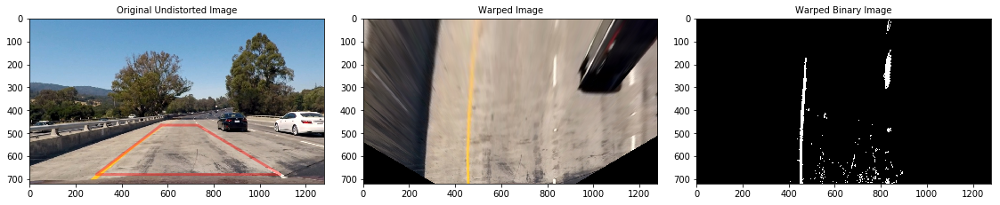

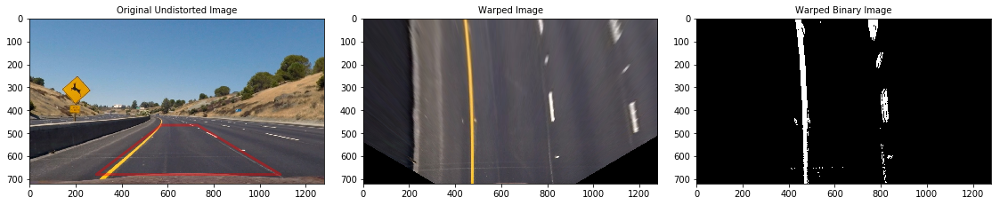

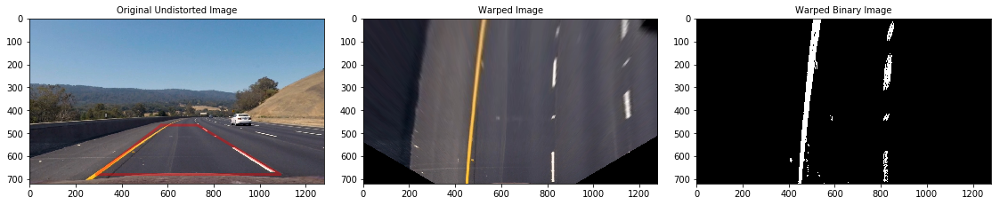

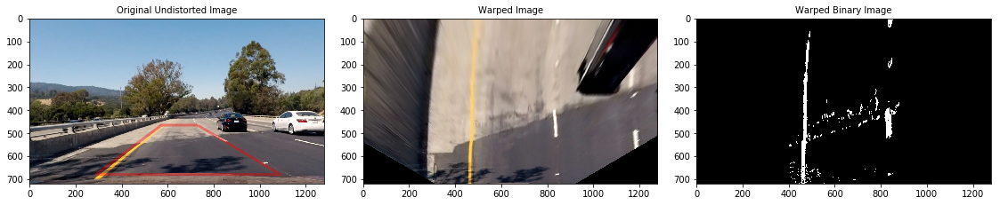

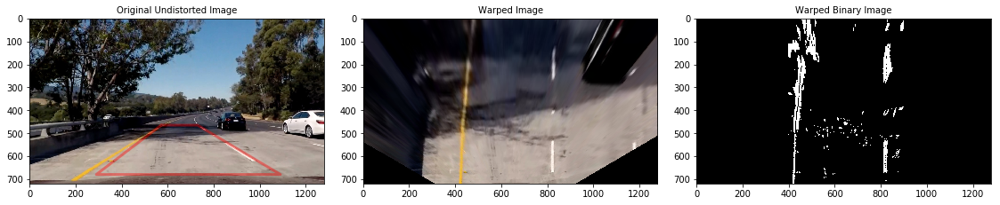

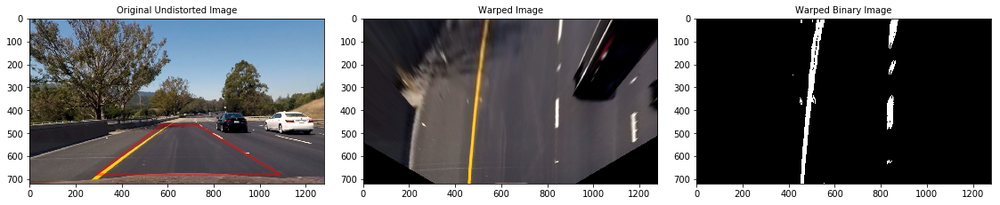

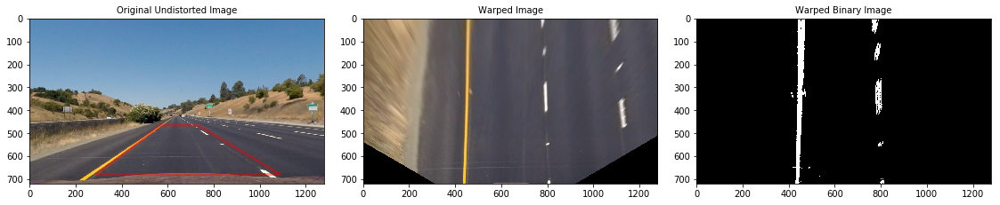

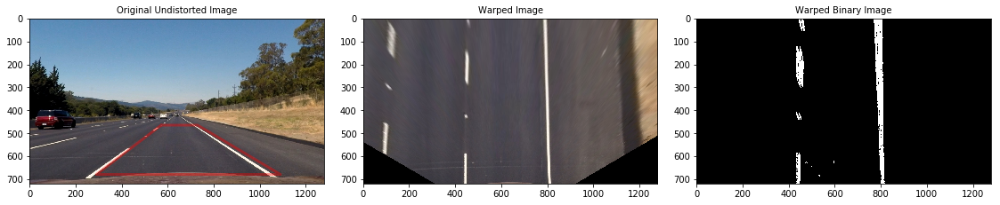

In [24]:
results = []
all_test_images = glob.glob('test_images/test*.jpg')
for idx, fname in enumerate(all_test_images):
    image = mpimg.imread(fname)
    results.append(pipeline(image, plot_images = True))

## Step 6: Locate Lane Lines

### 6.1 Peaks in  a Histogram
After applying calibration, thresholding, and a perspective transform to a road image, we now have a binary image where the lane lines stand out clearly. However, we still need to decide explicitly which pixels are part of the lines and which belong to the left line and which belong to the right line.

Computing a histogram along all the columns in the lower half of the image as shown below

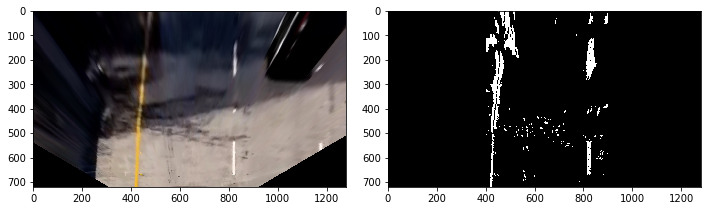

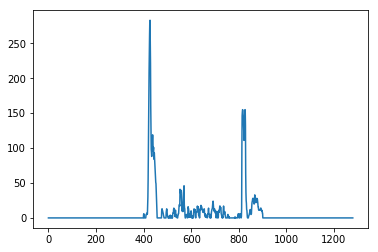

In [25]:
image = mpimg.imread('test_images/test5.jpg')
lanes_top_view, lanes_top_view_binary, Minv = pipeline(image)
histogram = np.sum(lanes_top_view_binary[lanes_top_view_binary.shape[0]//2:,:], axis=0)

f, (ax1, ax2) = plt.subplots(1, 2, figsize = (10,10))
f.tight_layout()
ax1.imshow(lanes_top_view)   
ax2.imshow(lanes_top_view_binary, cmap='gray')   
plt.figure()
plt.plot(histogram)

### 6.2 Sliding Window
After plotting the histogram, we now have an idea on starting position of the pixels from the bottom of the image which may form a lane. Run a sliding window search to capture the pixel co-ordinates of the lane lines.

*Text from lecture Notes*  
With the histogram, we are essentially adding up the pixel values along each column in the image. In our thresholded binary image, pixels are either 0 or 1, so the two most prominent peaks in this histogram will be good indicators of the x-position of the base of the lane lines. So use that as a starting point for where to search for the lines.  
From that point, we can use a sliding window, placed around the line centers, to find and follow the lines up to the top of the frame.

The following code has been taken from lecture notes

In [26]:
# Define method to fit polynomial to binary image with lines extracted, using sliding window
def sliding_window_polyfit(img):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    
    
    # Choose the number of sliding windows
    nwindows = 10
    # Set height of windows
    window_height = np.int(img.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 40
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    # Rectangle data for visualization
    window_boxes = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        window_boxes.append((win_y_low, win_y_high, win_xleft_low, win_xleft_high, win_xright_low, win_xright_high))
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    left_fit, right_fit = (None, None)
    # Fit a second order polynomial to each
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)    
     
    return left_fit, right_fit, left_lane_inds, right_lane_inds, window_boxes


### Visualize the result on test images

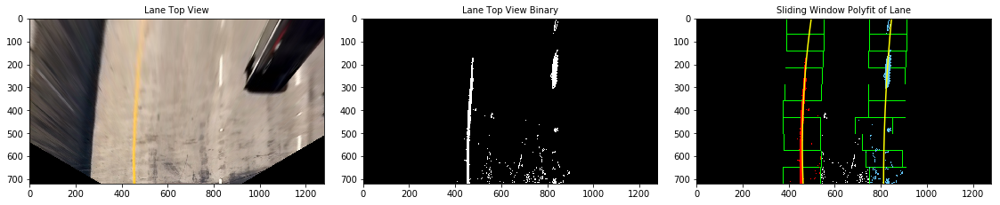

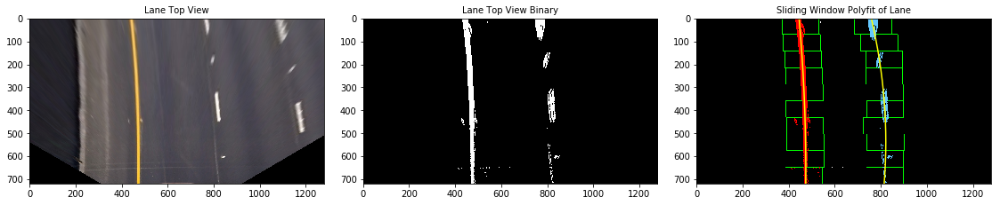

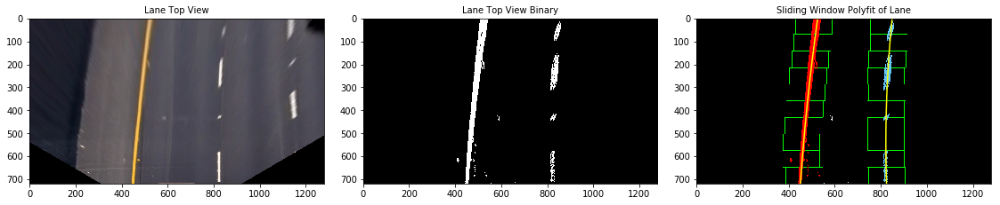

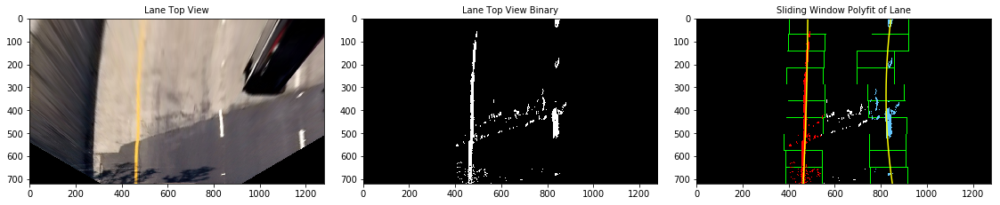

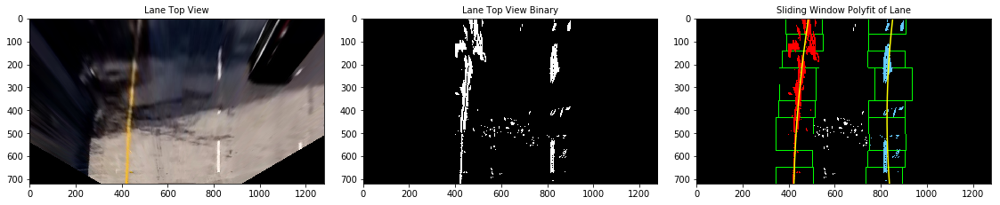

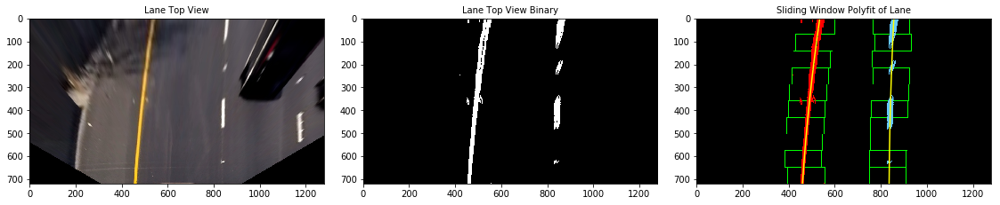

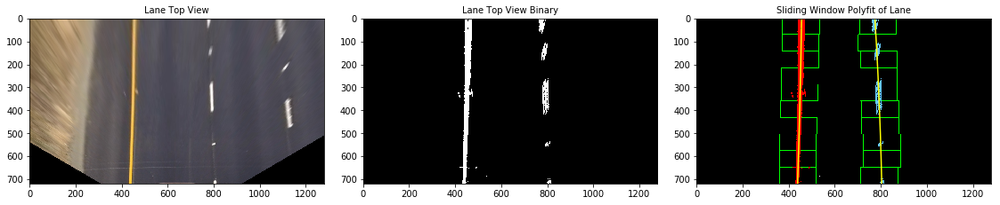

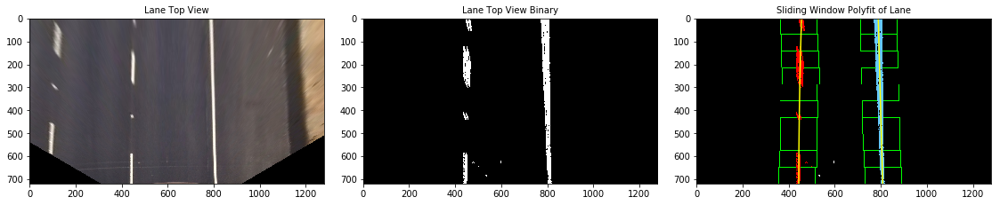

In [27]:
all_test_images = glob.glob('test_images/test*.jpg')
for idx, fname in enumerate(all_test_images):
    image = mpimg.imread(fname)
    top_view, top_binary, Minv = pipeline(image)

    left_fit, right_fit, left_lane_inds, right_lane_inds, window_boxes = sliding_window_polyfit(top_binary)

    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((top_binary, top_binary, top_binary))*255


    # Generate x and y values for plotting
    ploty = np.linspace(0, top_binary.shape[0]-1, top_binary.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    for box in window_boxes:
        # Draw boxes which follow lane detection
        cv2.rectangle(out_img,(box[2],box[0]),(box[3],box[1]),[0,255,0], 2) 
        cv2.rectangle(out_img,(box[4],box[0]),(box[5],box[1]),(0,255,0), 2) 

    # Plot the x and y positions of all nonzero pixels in the image
    nonzero = top_binary.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [100, 200, 255]
    
      
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 15))
    f.tight_layout()
    
    ax1.imshow(top_view)
    ax1.set_title('Lane Top View', fontsize=10)
    
    ax2.imshow(top_binary, cmap='gray')
    ax2.set_title('Lane Top View Binary', fontsize=10)

    ax3.imshow(out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    ax3.set_title('Sliding Window Polyfit of Lane', fontsize=10)

    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 6.3 Continous polyfit
Now, we know where the lines are in the fit.  In the next frame of video we don't need to do a blind search again, but instead we can just search in a margin around the previous line position.

In [28]:
def continous_polyfit(img, prev_left_fit, prev_right_fit):
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 80
    left_lane_inds = ((nonzerox > (prev_left_fit[0]*(nonzeroy**2) + prev_left_fit[1]*nonzeroy + prev_left_fit[2] - margin)) & 
                      (nonzerox < (prev_left_fit[0]*(nonzeroy**2) + prev_left_fit[1]*nonzeroy + prev_left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (prev_right_fit[0]*(nonzeroy**2) + prev_right_fit[1]*nonzeroy + prev_right_fit[2] - margin)) & 
                       (nonzerox < (prev_right_fit[0]*(nonzeroy**2) + prev_right_fit[1]*nonzeroy + prev_right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    if len(leftx) != 0:
        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
    return left_fit, right_fit, left_lane_inds, right_lane_inds

#### Lets now test it out on 2 continous frames of image

(720, 0)

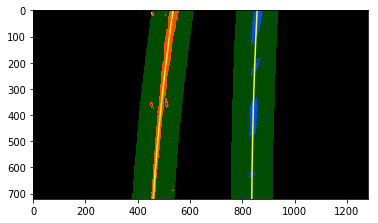

In [29]:
continous_frames = [mpimg.imread('chronological_images/Chron1.jpg'), mpimg.imread('chronological_images/Chron2.jpg')]
top_view, top_view_binary, Minv = pipeline(continous_frames[0])
top_view_nxt, top_view_binary_nxt, Minv_nxt = pipeline(continous_frames[0])
margin = 80


left_fit, right_fit, left_lane_inds, right_lane_inds, window_boxes = sliding_window_polyfit(top_view_binary)
left_fit_nxt, right_fit_nxt, left_lane_inds_nxt, right_lane_inds_nxt = continous_polyfit(top_view_binary_nxt, left_fit, right_fit)

# Generate x and y values for plotting
ploty = np.linspace(0, top_view_binary_nxt.shape[0]-1, top_view_binary_nxt.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
left_fitx_nxt = left_fit_nxt[0]*ploty**2 + left_fit_nxt[1]*ploty + left_fit_nxt[2]
right_fitx_nxt = right_fit_nxt[0]*ploty**2 + right_fit_nxt[1]*ploty + right_fit_nxt[2]

# Create an image to draw on and an image to show the selection window
out_img = np.uint8(np.dstack((top_view_binary_nxt, top_view_binary_nxt, top_view_binary_nxt))*255)
window_img = np.zeros_like(out_img)

# Color in left and right line pixels
nonzero = top_view_binary_nxt.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
out_img[nonzeroy[left_lane_inds_nxt], nonzerox[left_lane_inds_nxt]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds_nxt], nonzerox[right_lane_inds_nxt]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area 
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx_nxt - margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx_nxt + margin, ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx_nxt - margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx_nxt + margin, ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.imshow(result)
plt.plot(left_fitx_nxt, ploty, color='yellow')
plt.plot(right_fitx_nxt, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

The green shaded area shows where we searched for the lines this time. So, once you know where the lines are in one frame of video, you can do a highly targeted search for them in the next frame. This is equivalent to using a customized region of interest for each frame of video, and should help us track the lanes through sharp curves and tricky conditions. If you lose track of the lines, go back to sliding_window_polyfit() search to rediscover them.

### Another Sliding Window Search
*Text below taken from Lecture Notes*  
Another way to approach the sliding window method is to apply a convolution, which will maximize the number of "hot" pixels in each window. A convolution is the summation of the product of two separate signals, in our case the window template and the vertical slice of the pixel image.

You slide your window template across the image from left to right and any overlapping values are summed together, creating the convolved signal. The peak of the convolved signal is where there was the highest overlap of pixels and the most likely position for the lane marker.

Now let's try using convolutions to find the best window center positions in a thresholded road image. The code below allows you to experiment with using convolutions for a sliding window search function. We gave it a try but this method is not used in this project

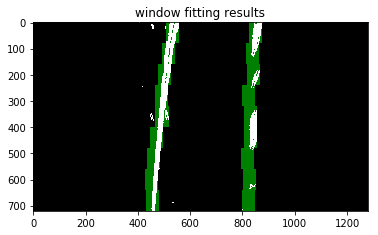

In [30]:
# Read in a thresholded image
top_view, warped, Minv = pipeline(continous_frames[0])
# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

window_centroids = find_window_centroids(warped, window_width, window_height, margin)

# If we found any window centers
if len(window_centroids) > 0:

    # Points used to draw all the left and right windows
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)

    # Go through each level and draw the windows 	
    for level in range(0,len(window_centroids)):
        # Window_mask is a function to draw window areas
        l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
        r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
        # Add graphic points from window mask here to total pixels found 
        l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
        r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

    # Draw the results
    template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    warpage= np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
else:
    output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

# Display the final results
plt.imshow(output)
plt.title('window fitting results')
plt.show()


### 6.4 Measuring Curvature
Compute the radius of curvature of the fit using the following formulae.
![](document_images/Radius_of_curvature.jpg)

In [31]:
def measure_curvature(top_view_binary, left_fit, right_fit, left_lane_inds, right_lane_inds):
    # Define conversions in x and y from pixels space to meters
    
    # The lane is about 30 meters long and 3.7 meters wide
    lane_width = 3.7
    lane_height = 30
    
    # Lane width in pixels ia about 380 and Image height is 720.
    lane_width_in_pixels = 380
    lane_height_in_pixels = 720
    
    ym_per_pix = lane_height / lane_height_in_pixels 
    xm_per_pix = lane_width / lane_width_in_pixels 
    left_curverad, right_curverad, center_dist = (0, 0, 0)
    
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    ploty = np.linspace(0, top_view_binary.shape[0]-1, top_view_binary.shape[0] )
    y_eval = np.max(ploty)
  
    # Plot the x and y positions of all nonzero pixels in the image
    nonzero = top_view_binary.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    if len(leftx) != 0: 
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        # Calculate the new radii of curvature
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    
    if len(rightx) != 0:
    
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)        
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    
    
    
    image_height = top_view_binary.shape[0]
    lane_mid_point = top_view_binary.shape[1]//2
    left_fitx_center = left_fit[0]*image_height**2 + left_fit[1]*image_height + left_fit[2]
    right_fitx_center = right_fit[0]*image_height**2 + right_fit[1]*image_height + right_fit[2]
    lane_center = (left_fitx_center + right_fitx_center) /2
    distance_from_center = (lane_mid_point - lane_center) * xm_per_pix
    
    return left_curverad, right_curverad, distance_from_center

In [32]:
image = mpimg.imread('test_images/test6.jpg')
top_view, top_view_binary, Minv = pipeline(image)
left_fit, right_fit, left_lane_inds, right_lane_inds, window_boxes = sliding_window_polyfit(top_view_binary)
left_curverad, right_curverad, distance_from_center = measure_curvature(top_view_binary, left_fit, right_fit, left_lane_inds, right_lane_inds)

print('Left Curve Radius is:', left_curverad)
print('Right Curve Radius is:', right_curverad)

print('Distance from center is:', distance_from_center)

Left Curve Radius is: 1614.8155548935208
Right Curve Radius is: 2926.9673111739517
Distance from center is: -0.07754868732298208


### 6.4 Draw Lane and Data on Image

In [33]:
def draw_lane_data(original_img, top_view_binary, left_fit, right_fit, left_lane_inds, right_lane_inds, Minv):
    
    new_img = np.copy(original_img)
       
     # Get Lane Curvature
    left_curverad, right_curverad, distance_from_center = measure_curvature(top_view_binary, left_fit, right_fit, 
                                                                            left_lane_inds, right_lane_inds)
    
    font = cv2.FONT_HERSHEY_DUPLEX
    text_left = 'Left Curvature: ' + '{:04.2f}'.format(left_curverad) + 'm'
    text_right = 'Right Curvature: ' + '{:04.2f}'.format(right_curverad) + 'm'
    
    if distance_from_center > 0:
        alignment = 'Right'
    else:
        alignment = 'Left'
    
    text_center = 'Alignment: ' + '{:04.2f}'.format(abs(distance_from_center)) + 'm to the ' + alignment
    cv2.putText(new_img, text_left, (50,70), font, 1.0, (211,211,211), 2, cv2.LINE_AA)
    cv2.putText(new_img, text_right, (800,70), font, 1.0, (211,211,211), 2, cv2.LINE_AA)
    cv2.putText(new_img, text_center, (375,120), font, 1.0, (200,255,155), 2, cv2.LINE_AA)
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(top_view_binary).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    ploty = np.linspace(0, top_view_binary.shape[0]-1, top_view_binary.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

   # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(new_img, 1, newwarp, 0.3, 0)
    
   
    return result     

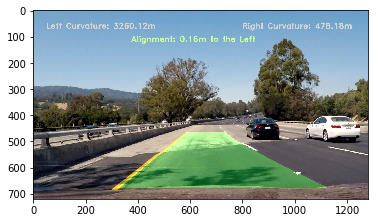

In [34]:
image = mpimg.imread('test_images/test4.jpg')
top_view, top_view_binary, Minv = pipeline(image)
left_fit, right_fit, left_lane_inds, right_lane_inds, window_boxes = sliding_window_polyfit(top_view_binary)
image_with_lane = draw_lane_data(image, top_view_binary, left_fit, right_fit, 
                                 left_lane_inds, right_lane_inds, Minv)
plt.imshow(image_with_lane)

### 6.5 Track detections on continous stream of images
After creating the pipeline on test images, we'll run on a video stream, just like in the first project. In this case, we're going to keep track of things like where the last several detections of the lane lines were and what the curvature was, so we can properly treat new detections. To do this, it's useful to define a Line() class to keep track of all the interesting parameters measured from frame to frame.  
We can create an instance of the Line() class for the left and right lane lines to keep track of recent detections and to perform sanity checks.


#### Sanity Check
1. Checking that they have similar curvature
2. Checking that they are separated by approximately the right distance horizontally
3. Checking that they are roughly parallel


#### Reset
If sanity checks reveal that the lane lines detected are problematic for some reason, we can simply assume it was a bad or difficult frame of video, retain the previous positions from the frame prior and step to the next frame to search again. If you lose the lines for several frames in a row, start searching from scratch using a histogram and sliding window, to re-establish your measurement.

#### Smoothing
Even when everything is working, line detections will jump around from frame to frame a bit and it can be preferable to smooth over the last n frames of video to obtain a cleaner result. Each time we get a new high-confidence measurement, we can append it to the list of recent measurements and then take an average over n past measurements to obtain the lane position we want to draw onto the image.


**Code Comments**
        1. Create Line() class to keep track of recent detections and to perform sanity checks.
        2. For every valid lane detected set self.detected = True. Each detection is appended to the list and then and an    average is taken over measurements to obtain the lane position we want to draw onto the image. This is called smoothing and is done to obtain a cleaner result. We call this average as our best fit
        3. After every 5 detections, discard last 4 and retain the latest detections.
        4. If the detection does not pass Sanity check or if the detection itself is not found, set self.detected = False.
        5. If self.detected is False, we start searching from scratch using a histogram and sliding window, to re-establish    our measurement.
        
        
The following class was loosely adapted from Jeremy Shannon's work [here](https://github.com/jeremy-shannon)

In [35]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = []  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.difference = np.array([0,0,0], dtype='float') 
        #number of detected pixels
        self.px_count = None
        self.fits_to_retain = 5
    
    def create_fit(self, fit, indicators):
        
        if fit is not None:
            if self.best_fit is not None:
                # Do we have the best fit. Check the best fit against previous fits
                self.difference = abs(fit - self.best_fit)
            if (self.difference[0] > 0.001 or self.difference[1] > 1.0 or self.difference[2] > 100.) and len(self.current_fit) > 0:
                # This is a bad fit
                self.detected = False
            else:
                self.detected = True
                self.px_count = np.count_nonzero(indicators)
                self.current_fit.append(fit)
                if len(self.current_fit) > self.fits_to_retain:
                    # Discard Old fits. Retain the last fit
                    self.current_fit = self.current_fit[len(self.current_fit) - self.fits_to_retain:]
                self.best_fit = np.average(self.current_fit, axis = 0)
        else:
            self.detected = False
            if len(self.current_fit) > 0:
                # Discard the last fit
                self.current_fit = self.current_fit[:len(self.current_fit)-1]
            if len(self.current_fit) > 0:
                # if there are still any fits in the queue, best_fit is their average
                self.best_fit = np.average(self.current_fit, axis=0)


**Initiate the Class to create instances for Left and Right Lanes**  
Create an instance of the Line() class for the left and right lane lines to keep track of recent detections and to perform sanity checks.

In [36]:
left_lane = Line()
right_lane = Line()

### 6.6 Track detections on continuous stream of images
Build this final pipeline to track detections on continuous stream of images.

In [42]:
def stream_lane_detection(image):
    new_img = np.copy(image)
    top_view, top_view_binary, Minv = pipeline(image)
    
    if not left_lane.detected or not right_lane.detected:
        left_fit, right_fit, left_lane_inds, right_lane_inds, window_boxes = sliding_window_polyfit(top_view_binary)
    else:
        left_fit, right_fit, left_lane_inds, right_lane_inds = continous_polyfit(top_view_binary, 
                                                                                 left_lane.best_fit, 
                                                                                 right_lane.best_fit)
        
            
    left_lane.create_fit(left_fit, left_lane_inds)
    right_lane.create_fit(right_fit, right_lane_inds)
    
    # Plot the best fit
    if left_lane.best_fit is not None and right_lane.best_fit is not None:
        final_image = model_test(new_img)
        final_image = draw_lane_data(final_image, top_view_binary, left_lane.best_fit, right_lane.best_fit, 
                                     left_lane_inds, right_lane_inds, Minv)
        
    else:
        final_image = new_img
    
    
    return final_image

### 6.7 Combine Vehicle Detections
Use our Vehicle detection pipeline to detect both Lanes and Vehicles.

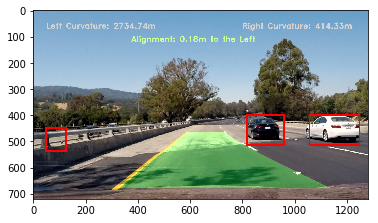

In [44]:
image = mpimg.imread('test_images/test4.jpg')
final_image = stream_lane_detection(image)
plt.imshow(final_image)

In [45]:
project_video_output =  'Videos/project_video_output.mp4'   
clip = VideoFileClip('Videos/project_video.mp4')
image_clip = clip.fl_image(stream_lane_detection)
%time image_clip.write_videofile(project_video_output, audio=False)

[MoviePy] >>>> Building video Videos/project_video_output.mp4
[MoviePy] Writing video Videos/project_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [31:24<00:01,  1.50s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: Videos/project_video_output.mp4 

Wall time: 31min 24s


In [46]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_video_output))